In [1]:
from pathlib import Path
import os
import pandas as pd
import numpy as np
import cv2

os.chdir(Path(os.getcwd()).parent)

from src.mslm.dataloader import KeypointDataset
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


/home/giorgio6846/miniconda3/envs/Sign/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
class KeypointProcessingGraph():
    def __init__(self):
        # skeleton de COCO + manos
        # topología COCO-25 (pose + cuello + cabeza) 
        self.BODY_EDGES = [
            (0, 1), (0, 4), (1, 4),
            (1, 2), (2, 3), (4, 5), (5, 6),
            (7, 8), (8, 9), (9, 10), (10, 11), (11, 12), (12, 13), (13, 14), (14, 15), (15, 16), (16, 17), (17, 18), 
            (19, 20), (20, 21), (21, 22), (22, 23),             # ceja derecha
            (24, 25), (25, 26), (26, 27), (27, 28),             # ceja izquierda
            (38, 39), (39, 40), (40, 41), (41, 42), (42, 43),   # ojo derecho
            (44, 45), (45, 46), (46, 47), (47, 48), (48, 49),   # ojo izquierdo
            (50, 51), (51, 52), (52, 53), (53, 54), (54, 55),   # labio superior
            (56, 57), (57, 58), (58, 59), (59, 60), (61, 62), (62, 63),   # labio inferior
            (64, 65), (65, 66), (66, 67), (67, 68), (68, 69),             # se parador labio
        ]
        
        self.HAND_EDGES = [
            (3, 107), (107, 108),(108, 109),(109, 110),
            (3, 103), (103, 104),(104, 105),(105, 106),
            (3, 99), (99, 100),(100,101),(101,102),
            (3, 95), (95, 96),(96,97),(97,98),
            (3,90), (90, 91),(91,92),(92,93), (93,94),
        ]

        self.HAND_TEMPLATE = [
            (0,1),(1,2),(2,3),(3,4),
            (0,5),(5,6),(6,7),(7,8),
            (0,9),(9,10),(10,11),(11,12),
            (0,13),(13,14),(14,15),(15,16),
            (0,17),(17,18),(18,19),(19,20),
        ]

        self.body_kpts = 71
        self.hand_kpts = 20


    def build_skeleton_graph(self, kpts):
        """
        kpts: Tensor of shape [N, 2] con todas las coordenadas x,y.
        N = body_kpts + 2*hand_kpts
        """
        print(kpts.shape)
        # assert kpts.shape[0] == self.body_kpts + 2*self.hand_kpts
        G = nx.Graph()
        # nodos
        for i, (x,y) in enumerate(kpts.tolist()):
            G.add_node(i, x=x, y=y)
        # cuerpo
        G.add_edges_from(self.BODY_EDGES)
        # mano izquierda
        left_hand_offset = 70
        lh_edges = [(6, left_hand_offset)] + [
            (u + left_hand_offset, v + left_hand_offset)  for u, v in self.HAND_TEMPLATE
        ]
        G.add_edges_from(lh_edges)
        # mano derecha

        right_hand_offset = 90
        if G.degree[right_hand_offset] > 0:
            for neighbor in list(G.neighbors(right_hand_offset)):
                G.remove_edge(right_hand_offset, neighbor)

        rh_edges = [(3, right_hand_offset)] + [
            (u + right_hand_offset, v + right_hand_offset) for u, v in self.HAND_TEMPLATE
        ]
        G.add_edges_from(rh_edges)
        A = nx.adjacency_matrix(G).todense()

        return G, A

In [3]:
def preview_video(index, kd):
    if index >= len(kd):
        raise ValueError("index mayor a video")
    
    keypoints = kd[index][0]  # [T, K, 2]
    print(keypoints.size())   # (T, K, 2)
    print(kd[index][2])       # nombre u otra metadata

    # Grafo del esqueleto
    kpg = KeypointProcessingGraph()
    
    fig, ax = plt.subplots(figsize=(6, 6))
    scat = ax.scatter(keypoints[0, :, 0], keypoints[0, :, 1], s=20, c='blue')
    lines = []

    for (i, j) in kpg.SKELETON:
        if i < keypoints.shape[1] and j < keypoints.shape[1]:
            line, = ax.plot(
                [keypoints[0, i, 0], keypoints[0, j, 0]],
                [keypoints[0, i, 1], keypoints[0, j, 1]],
                color='green', linewidth=1
            )
            lines.append(line)

    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    ax.invert_yaxis()
    ax.set_title("Frame 0")

    def update(frame_index):
        points = keypoints[frame_index]
        scat.set_offsets(points)

        for line, (i, j) in zip(lines, kpg.SKELETON):
            if i < keypoints.shape[1] and j < keypoints.shape[1]:
                xi, yi = points[i]
                xj, yj = points[j]
                line.set_data([xi, xj], [yi, yj])

        ax.set_title(f"Frame {frame_index}")
        return (scat, *lines)

    anim = FuncAnimation(
        fig,
        update,
        frames=keypoints.shape[0],
        interval=33,
        blit=True
    )
    return HTML(anim.to_jshtml())


In [4]:
def preview_video_skeleton(index, kd):
    if index >= len(kd):
        raise ValueError("index mayor a video")
    
    keypoints = kd[index][0]  # [T, K, 2]
    print(kd[index][2])       # nombre u otra metadata
    kpg = KeypointProcessingGraph()
    
    # construye el grafo para el primer frame:
    pts0 = keypoints[0]         # [K,2]
    G0, A = kpg.build_skeleton_graph(pts0)  # nodos 0..K-1, con x/y attrs
    # save A
    print(f"Adjacency matrix shape: {A.shape}")
    np.save("adjacency_matrix.npy", A)
    
    fig, ax = plt.subplots(figsize=(16, 16))
    scat = ax.scatter(pts0[:,0], pts0[:,1], s=20, c='blue')
    lines = [
        ax.plot(
            [pts0[i,0], pts0[j,0]],
            [pts0[i,1], pts0[j,1]],
            color='green', linewidth=1
        )[0]
        for i,j in G0.edges()
    ]
    texts = [
        ax.text(x+0.01, y-0.01, str(i), fontsize=6, color='red')
        for i,(x,y) in enumerate(pts0)
    ]

    ax.set_xlim(0,1); ax.set_ylim(0,1); ax.invert_yaxis()
    ax.set_title("Frame 0")

    def update(fi):
        pts = keypoints[fi]
        scat.set_offsets(pts)
        for line, (i,j) in zip(lines, G0.edges()):
            xi, yi = pts[i]; xj, yj = pts[j]
            line.set_data([xi, xj], [yi, yj])
        for i, txt in enumerate(texts):
            x, y = pts[i]
            txt.set_position((x+0.01, y-0.01))
        ax.set_title(f"Frame {fi}")
        return (scat, *lines, *texts)

    anim = FuncAnimation(fig, update, frames=keypoints.shape[0],
                         interval=33, blit=True)
    return HTML(anim.to_jshtml())

In [5]:
datasetPath = "/home/giorgio6846/Code/Sign-AI/data/processed/dataset_v5.hdf5"
kd = KeypointDataset(datasetPath, return_label=True)

In [13]:
!cd ../data/processed/ && pwd

/home/giorgio6846/Code/Sign-AI/data/processed


ayuda
torch.Size([111, 2])
Adjacency matrix shape: (111, 111)


Animation size has reached 21113477 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


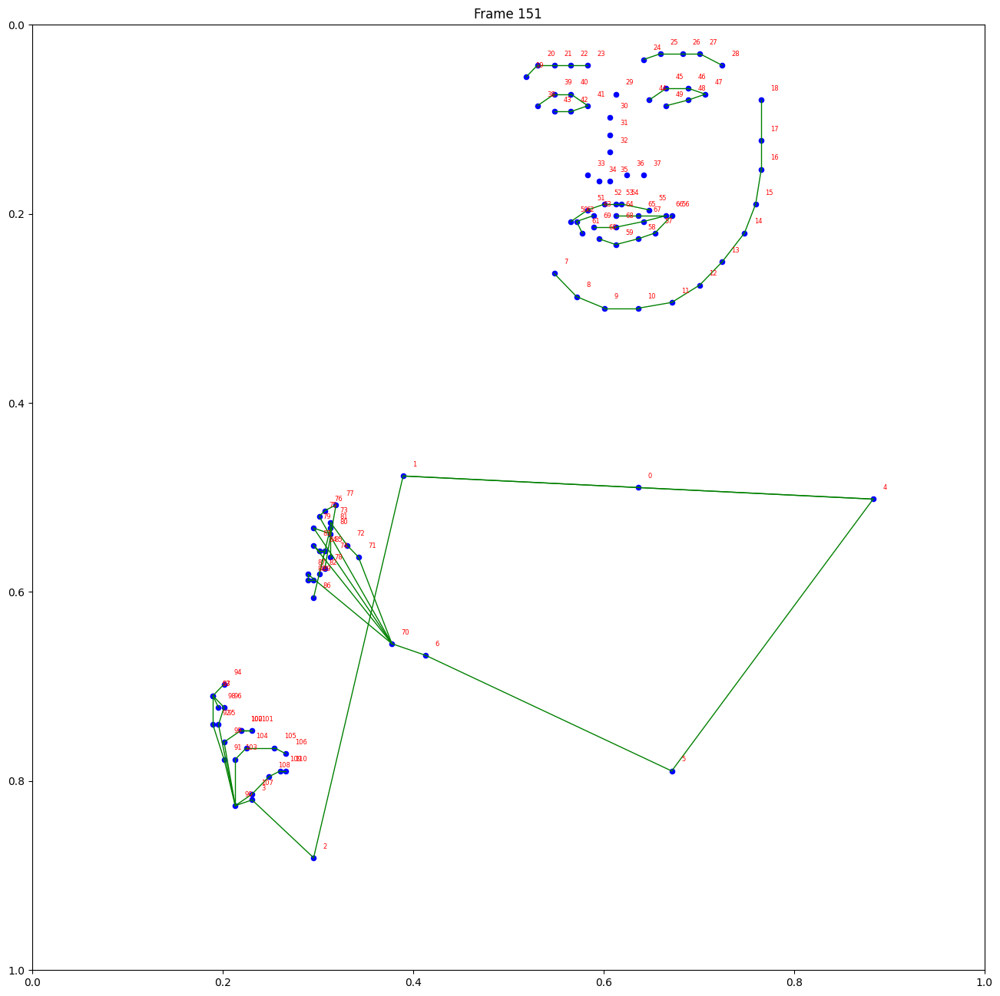

In [ ]:
preview_video_skeleton(2000, kd)